In [102]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import folium
from shapely.geometry import Point
import contextily as cx

### Starting out, health/socioecon data

In [2]:
tz_regions_health = pd.read_csv('exported_data/tz_regions_health.csv').rename(columns={'Unnamed: 0': 'Region'})
tz_regions_socioecon = pd.read_csv('exported_data/tz_regions_socioecon.csv')

In [3]:
tz_regions_health[(tz_regions_health['Time Period'] == '2010') & (tz_regions_health['Source'] == 'NBS_ TDHS (2010)_2011')].head()

,Region,Indicator,Unit,Subgroup,Area,Area ID,Time Period,Source,Data Value,Footnotes
25,6128,Children under-5 years with diarrhoea,Percent,Total,Mtwara,TZA001009,2010,NBS_ TDHS (2010)_2011,13.7,"TZA_ Demographic & Health Survey, 2010, Nation..."
26,6129,Children under-5 years with diarrhoea,Percent,Total,Ruvuma,TZA001010,2010,NBS_ TDHS (2010)_2011,9.7,"TZA_ Demographic & Health Survey, 2010, Nation..."
27,6130,Children under-5 years with diarrhoea,Percent,Total,Iringa,TZA001011,2010,NBS_ TDHS (2010)_2011,15.3,"TZA_ Demographic & Health Survey, 2010, Nation..."
28,6131,Children under-5 years with diarrhoea,Percent,Total,Mbeya,TZA001012,2010,NBS_ TDHS (2010)_2011,17.6,"TZA_ Demographic & Health Survey, 2010, Nation..."
29,6132,Children under-5 years with diarrhoea,Percent,Total,Singida,TZA001013,2010,NBS_ TDHS (2010)_2011,15.9,"TZA_ Demographic & Health Survey, 2010, Nation..."


In [4]:
tz_regions_geo = gpd.read_file('Districts_Shapefiles_2019/Districts and TC as 2020.shp')
tz_regions_geo = tz_regions_geo.dissolve('Region_Nam')
tz_regions_geo = tz_regions_geo.drop(columns=['District_C', 'NewDist20'])

In [172]:
tz_regions_geo.to_crs(epsg=32737, inplace=True)

In [151]:
tz_regions_geo_full = gpd.read_file('Districts_Shapefiles_2019/Districts and TC as 2020.shp')
tz_regions_geo_full

,Region_Nam,Region_Cod,District_C,NewDist20,geometry
0,Arusha,2,6,Arusha DC,"MULTIPOLYGON (((36.82313 -3.44493, 36.82293 -3..."
1,Arusha,2,3,Arusha MC,"POLYGON ((36.63328 -3.36609, 36.63297 -3.36625..."
2,Arusha,2,4,Karatu DC,"POLYGON ((35.89234 -3.25703, 35.88714 -3.26276..."
3,Arusha,2,7,Longido DC,"MULTIPOLYGON (((36.35823 -3.05980, 36.35809 -3..."
4,Arusha,2,2,Meru DC,"POLYGON ((36.90033 -3.05354, 36.90150 -3.05390..."
...,...,...,...,...,...
190,Songwe,26,5,Songwe DC,"POLYGON ((32.89625 -6.93692, 32.89573 -6.96095..."
191,Mara,20,9,Tarime TC,"POLYGON ((34.38746 -1.28793, 34.39209 -1.28903..."
192,Dar-es-salaam,7,4,Ubungo MC,"POLYGON ((39.16298 -6.69287, 39.16315 -6.69296..."
193,Mara,20,7,Butiama DC,"POLYGON ((34.29664 -1.46716, 34.29644 -1.46806..."


In [149]:
ud = list(tz_regions_geo_full['NewDist20'].unique())
matches = []
for i in list(water_pumps['district_code']):
    if i in list(ud):
        matches.append(i)

set(matches)

{'Kaskazini A',
 'Kaskazini B',
 'Kati',
 'Kusini',
 'Magharibi A',
 'Magharibi B',
 'Mjini',
 'Mkoani'}

In [158]:
# set(tz_regions_geo_full['NewDist20']), set(water_pumps[''])

{'Arusha DC',
 'Arusha MC',
 'Babati DC',
 'Babati MC',
 'Bagamoyo DC',
 'Bahi DC',
 'Bariadi DC',
 'Bariadi TC',
 'Biharamulo DC',
 'Buchosa DC',
 'Buhigwe DC',
 'Bukoba DC',
 'Bukoba MC',
 'Bukombe DC',
 'Bumbuli DC',
 'Bunda DC',
 'Bunda TC',
 'Busega DC',
 'Busokelo DC',
 'Butiama DC',
 'Chake Chake',
 'Chalinze DC',
 'Chamwino DC',
 'Chato DC',
 'Chemba DC',
 'Chunya DC',
 'Dodoma CC',
 'Gairo DC',
 'Geita DC',
 'Geita TC',
 'Hai DC',
 'Hanang DC',
 'Handeni DC',
 'Handeni TC',
 'Ifakara TC',
 'Igunga DC',
 'Ikungi DC',
 'Ilala MC',
 'Ileje DC',
 'Ilemela MC',
 'Iramba DC',
 'Iringa DC',
 'Iringa MC',
 'Itigi DC',
 'Itilima DC',
 'Kahama TC',
 'Kakonko DC',
 'Kalambo DC',
 'Kaliua DC',
 'Karagwe DC',
 'Karatu DC',
 'Kaskazini A',
 'Kaskazini B',
 'Kasulu DC',
 'Kasulu TC',
 'Kati',
 'Kibaha DC',
 'Kibaha TC',
 'Kibiti DC',
 'Kibondo DC',
 'Kigamboni MC',
 'Kigoma DC',
 'Kigoma Municipal-Ujiji',
 'Kilindi DC',
 'Kilolo DC',
 'Kilombero DC',
 'Kilosa DC',
 'Kilwa DC',
 'Kinondoni MC

In [5]:
type(tz_regions_geo)

geopandas.geodataframe.GeoDataFrame

In [6]:
tz_geo_diarrhoea = tz_regions_geo.merge(right=(tz_regions_health[(tz_regions_health['Time Period'] == '2010') & 
    (tz_regions_health['Source'] == 'NBS_ TDHS (2010)_2011')]), how='left',right_on='Area', left_index=True)
tz_geo_diarrhoea.explore(
    column='Data Value',
    cmap='inferno',
    tooltip=['Area', 'Data Value'],
    legend=True,
    k=5,
    vmin=0,
    vmax=30)
# tz_regions_geo.merge()

In [7]:
tz_regions_geo.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

### Trying to add water pumps

In [8]:
water_pumps = pd.read_csv('./data/Pump_it_Up_Data_Mining_the_Water_Table_-_Training_set_values.csv')
water_pumps_targets = pd.read_csv('./data/Pump_it_Up_Data_Mining_the_Water_Table_-_Training_set_labels.csv')
water_pumps = pd.merge(left=water_pumps, right=water_pumps_targets, on='id', how='left')

In [9]:
map_tz_geo = tz_geo_diarrhoea.explore(
    column='Data Value',
    cmap='inferno',
    tooltip=['Area', 'Data Value'],
    legend=True,
    k=5,
    vmin=0,
    vmax=30)

In [10]:
# folium.FeatureGroup(name='My Points', show=False)
# water_pumps.groupby('region').aggregate(['count'])['id'].dtypes
# tz_geo_diarrhoea

In [11]:
tz_geo_all_data = tz_geo_diarrhoea.merge(right=(water_pumps.groupby('region').aggregate(['count'])['id']), how='left', right_index=True, left_on='Area')

In [12]:
water_pumps['geometry'] = [Point(xy) for xy in zip(water_pumps['longitude'], water_pumps['latitude'])] 

water_pumps[['source', 'water_quality', 'geometry', 'region']]

/Users/kalebtsegaye/opt/anaconda3/envs/geo_env/lib/python3.9/site-packages/pandas/core/dtypes/cast.py:122: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  arr = construct_1d_object_array_from_listlike(values)


,source,water_quality,geometry,region
0,spring,soft,POINT (34.93809275 -9.85632177),Iringa
1,rainwater harvesting,soft,POINT (34.6987661 -2.14746569),Mara
2,dam,soft,POINT (37.46066446 -3.82132853),Manyara
3,machine dbh,soft,POINT (38.48616088 -11.15529772),Mtwara
4,rainwater harvesting,soft,POINT (31.13084671 -1.82535885),Kagera
...,...,...,...,...
59395,spring,soft,POINT (37.16980689 -3.25384746),Kilimanjaro
59396,river,soft,POINT (35.24999126 -9.0706288),Iringa
59397,machine dbh,fluoride,POINT (34.01708706 -8.75043433),Mbeya
59398,shallow well,soft,POINT (35.86131531 -6.37857327),Dodoma


In [13]:
# tz_regions_geo.to_file("tz_regions.geojson", driver='GeoJSON')
# temp = gpd.read_file("tz_regions.geojson")

In [14]:
water_pumps_layer = folium.Choropleth(geo_data="tz_regions.geojson", data=tz_geo_all_data['count'],
    # key_on='feature.properties.myvalue'
)

#  map_tz_geo.add_child(folium.FeatureGroup(name='Water Pumps', show=False))

# WAY TOO MANY POINTS, DO NOT RUN (unless you want to)
# count = 0
# for pump in water_pumps[['source', 'water_quality', 'geometry', 'region']].iterrows():
#     pump_point = pump[1][2]
#     if pump[1][3] in ['Kagera', 'Manyara']:
#         tz_geo_diarrhoea_water_pumps.add_child(folium.Marker(location=(pump_point.xy[1][0], pump_point.xy[0][0])))
#     # if count==50:
#     #     break
#     # else:
#     #     count += 1
water_pumps_layer

In [15]:
# water_pumps_layer.add_to(map_tz_geo)
# folium.LayerControl().add_to(map_tz_geo)

In [16]:
map_tz_geo

In [17]:
tz_geo_diarrhoea.explore().save('tz_map_1.html')
map_tz_geo.save('tz_map_2.html')

In [18]:
# tz_geo_diarrhoea_water_pumps
# tz_geo_diarrhoea_water_pumps=folium.FeatureGroup(name='', show=False)

In [548]:
water_gdf = pd.read_csv('cleaned_data_sb/geo_func_precip_util_joined.csv') # read sb's dataset
water_gdf

,Region_Nam,geometry,Region_Cod,functional_percentage,non_functional_percentage,functional_need_repair_percentage,waterpoint_counts,range,avg_range_by_quartiles,avg_range_by_halves,...,sanitation_limited_2010,sanitation_limited_2012,sanitation_limited_2016,sanitation_limited_2017,sanitation_opendef_2005,sanitation_opendef_2008,sanitation_opendef_2010,sanitation_opendef_2012,sanitation_opendef_2016,sanitation_opendef_2017
0,Arusha,POLYGON ((35.83184446790469 -3.428818590220729...,2,68.5,26.3,5.2,1808,624.11,415.978,270.380,...,8.63041,7.49078,18.35768,23.92370,27.77759,35.53375,30.87029,29.19030,19.26900,11.71480
1,Dar-es-salaam,MULTIPOLYGON (((39.31691387384456 -6.815569088...,7,57.3,42.4,0.4,805,1055.36,705.130,439.156,...,17.67950,40.25087,39.11605,50.72939,0.15622,0.03345,0.58065,0.36221,0.02435,0.06616
2,Dodoma,MULTIPOLYGON (((35.77502976901766 -7.089901410...,1,45.8,44.7,9.5,1959,603.45,327.146,202.504,...,1.77990,18.07448,5.95140,2.87941,10.98033,20.27825,19.43768,19.55768,6.88917,4.00190
3,Iringa,"POLYGON ((35.98174505800188 -8.40393572145058,...",11,78.2,19.5,2.3,5294,549.56,318.622,203.205,...,5.05787,3.63771,17.45834,16.48218,4.78384,5.12901,1.28451,0.00407,1.52949,1.04390
4,Kagera,MULTIPOLYGON (((31.6073588754349 -2.4143439428...,18,52.1,38.8,9.2,4006,444.78,348.970,251.212,...,1.57478,3.57445,4.47440,15.23150,11.13646,16.08014,12.33182,7.43330,1.96823,2.23443
5,Kigoma,MULTIPOLYGON (((31.244209459377732 -4.99747466...,16,48.4,30.2,21.4,2093,430.39,273.504,159.485,...,6.21314,9.14490,3.78111,17.49807,7.84179,9.25373,2.67752,5.76185,9.58617,3.22725
6,Kilimanjaro,POLYGON ((38.39025743298565 -4.100474548211634...,3,60.3,32.4,7.4,2635,981.11,605.600,401.188,...,7.46611,12.44188,13.03514,9.30129,0.94267,1.22011,0.89989,0.62874,2.47374,0.63983
7,Lindi,MULTIPOLYGON (((39.65273838067496 -9.460156661...,8,64.2,29.8,6.0,1969,893.42,658.790,444.706,...,6.10867,4.20219,4.11546,20.14632,6.84266,17.45817,10.55927,12.29840,3.49372,2.87437
8,Manyara,MULTIPOLYGON (((37.362913740430116 -5.21537609...,21,62.3,31.6,6.1,4639,655.33,429.638,264.801,...,0.84848,1.65147,3.04418,17.33506,17.85790,25.08899,27.73863,23.13686,24.32159,8.19356
9,Mara,MULTIPOLYGON (((33.33356630142189 -2.285716941...,20,52.0,45.0,3.0,4982,753.51,482.828,292.595,...,4.01491,12.90005,9.67339,27.02206,41.31676,31.71321,38.27524,37.58569,28.43281,19.33737


### Moving on to Sb's cleaned water data

In [550]:
water_gdf = pd.read_csv('cleaned_data_sb/geo_func_precip_util_joined.csv') # read sb's dataset

water_gdf = gpd.GeoDataFrame( pd.merge(mixed_tz, water_gdf.drop('geometry', axis=1), left_on='Region', right_on='Region_Nam') )

water_gdf.crs = mixed_tz.crs

In [551]:
water_gdf[['Region_Nam', 'geometry', 'functional_percentage', 'non_functional_percentage', 'functional_need_repair_percentage']].isnull().sum()

Region_Nam                           0
geometry                             0
functional_percentage                0
non_functional_percentage            0
functional_need_repair_percentage    0
dtype: int64

In [21]:
tz_geo_pump_function = water_gdf[['Region_Nam', 'geometry', 'functional_percentage', 'non_functional_percentage']].explore(
    column='functional_percentage',
    cmap='inferno',
    tooltip=['Region_Nam', 'functional_percentage'],
    legend=True,
    k=5,
)
# tz_geo_pump_function.add_child(folium.FeatureGroup(name='Water Pumps', show=False))
# water_gdf[['Region_Nam', 'geometry', 'non_functional_percentage']].explore(
#     m=tz_geo_pump_function,
#     column='non_functional_percentage',
#     cmap='inferno',
#     tooltip=['Region_Nam', 'non_functional_percentage'],
#     legend=True,
#     k=5,
#     # tiles='OpenStreetMap'
#     # vmin=0,
#     # vmax=30
# ).add_to(tz_geo_pump_function)

# nf_choro = folium.Choropleth(
#     geo_data=water_gdf,
#     data=water_gdf,
#     columns=['Region_Nam', 'non_functional_percentage'],
#     fill_color='YlGn'
# )

# folium.Tooltip(['Region_Nam', 'non_functional_percentage']).add_child(nf_choro.geojson)

# fgroup_nf = folium.FeatureGroup(name="Non-functional percentage", show=False)

# fgroup_nf.add_child(nf_choro)
    
    # key_on='feature.id'
# water_gdf[['Region_Nam', 'geometry', 'non_functional_percentage']].explore(
#     m=tz_geo_pump_function,
#     column='non_functional_percentage',
#     cmap='inferno',
#     tooltip=['Region_Nam', 'non_functional_percentage'],
#     legend=True,
#     k=5,
    # tiles='OpenStreetMap'
    # vmin=0,
    # vmax=30
# )

# folium.Choropleth(
#     geo_data=water_gdf,
#     data=water_gdf,
#     columns=['Region_Nam', 'non_functional_percentage'],

# ).add_to(tz_geo_pump_function)


# tz_geo_pump_function.add_child(fgroup_nf)

# tz_geo_pump_function.add_child(folium.LayerControl())  # use folium to add layer control


In [22]:
tz_geo_pump_function

#### Making the pump functionality maps

In [552]:

columns = ['functional_percentage', 'non_functional_percentage', 
'functional_need_repair_percentage']

for col in columns:
    tz_geo_pump_function = water_gdf[['Region_Nam', 'geometry', 'functional_percentage', 'non_functional_percentage', 
    'functional_need_repair_percentage']].explore(
        column=col,
        cmap='viridis',
        tooltip=['Region_Nam', col],
        legend=True,
        k=5,
    )

    tz_geo_pump_function.save('maps_kalebts/tz_map_' + col + '.html')

# folium.Tooltip(
#     fields=['Region_Nam', col],
#     aliases=['Region', " ".join(col.split('_')).capitalize()]
# )

# tz_geo_pump_function.add_child(

#     folium.GeoJsonTooltip(
#         fields=['Region_Nam', col],
#         aliases=['Region', " ".join(col.split('_')).capitalize()]
#     )
# )



In [24]:
sb_water_df = pd.read_csv('cleaned_data_sb/geo_func_precip_util_joined.csv') # read sb's dataset

In [25]:
pd.DataFrame(sb_water_df[['functional_percentage','non_functional_percentage', 'functional_need_repair_percentage']].agg('mean'),).T

,functional_percentage,non_functional_percentage,functional_need_repair_percentage
0,56.5,36.8,6.72381


In [452]:
st_functional_pumps_df = sb_water_df[['Region_Nam', 'functional_percentage','non_functional_percentage', 'functional_need_repair_percentage']]

st_functional_pumps_df.

AttributeError: 'DataFrame' object has no attribute 'crs'

In [519]:
mixed_tz

,admin2,geometry
0,Kagera,"POLYGON ((31.99806 -0.99322, 31.99892 -0.99323..."
1,Mara,"POLYGON ((33.43774 -0.99369, 33.46417 -0.99364..."
2,Mwanza,"POLYGON ((34.02639 -2.20420, 34.02917 -2.20976..."
3,Shinyanga,"POLYGON ((35.20004 -2.49917, 35.19806 -2.50889..."
4,Kilimanjaro,"POLYGON ((37.47156 -2.92003, 37.48419 -2.92650..."
5,Kigoma,"POLYGON ((30.83719 -3.13228, 30.82860 -3.12053..."
6,Singida,"POLYGON ((34.17861 -4.16427, 34.18528 -4.15399..."
7,Tabora,"POLYGON ((34.17861 -4.16427, 34.17500 -4.16899..."
8,Tanga,"POLYGON ((38.76811 -4.36029, 38.78032 -4.37056..."
9,Dodoma,"POLYGON ((37.00465 -5.97211, 37.00513 -5.97367..."


In [524]:
mixed_tz.merge((sb_water_df[['Region_Nam', 'functional_percentage',
    'non_functional_percentage', 'functional_need_repair_percentage']]), left)

,Region_Nam,functional_percentage,non_functional_percentage,functional_need_repair_percentage
0,Arusha,68.5,26.3,5.2
1,Dar-es-salaam,57.3,42.4,0.4
2,Dodoma,45.8,44.7,9.5
3,Iringa,78.2,19.5,2.3
4,Kagera,52.1,38.8,9.2
5,Kigoma,48.4,30.2,21.4
6,Kilimanjaro,60.3,32.4,7.4
7,Lindi,64.2,29.8,6.0
8,Manyara,62.3,31.6,6.1
9,Mara,52.0,45.0,3.0


In [40]:
st_functional_pumps_df = sb_water_df[['Region_Nam', 'functional_percentage','non_functional_percentage', 'functional_need_repair_percentage']]

st_functional_pumps_df = pd.DataFrame(columns=['Region', 'Status', 'Percentage'])

for i in ['functional','non_functional', 'functional_need_repair']:
    status_df = pd.DataFrame()
    status_df['Region'] = sb_water_df['Region_Nam']
    status_df['Status'] = i
    status_df['Percentage'] = sb_water_df[i+'_percentage']
    st_functional_pumps_df = pd.concat([st_functional_pumps_df, status_df], axis=0)

st_functional_pumps_df.to_csv('st_data/st_functional_pumps.csv')

In [42]:
st_functional_pumps_df.sort_values('Region')

,Region,Status,Percentage
0,Arusha,functional,68.5
0,Arusha,non_functional,26.3
0,Arusha,functional_need_repair,5.2
1,Dar-es-salaam,functional,57.3
1,Dar-es-salaam,non_functional,42.4
...,...,...,...
19,Tabora,functional,54.4
19,Tabora,non_functional,43.3
20,Tanga,functional,56.4
20,Tanga,non_functional,40.8


In [27]:
type(water_gdf)

geopandas.geodataframe.GeoDataFrame

In [29]:
sb_water_df[['Region_Nam', 'functional_percentage','non_functional_percentage', 
            'functional_need_repair_percentage']]

,Region_Nam,functional_percentage,non_functional_percentage,functional_need_repair_percentage
0,Arusha,68.5,26.3,5.2
1,Dar-es-salaam,57.3,42.4,0.4
2,Dodoma,45.8,44.7,9.5
3,Iringa,78.2,19.5,2.3
4,Kagera,52.1,38.8,9.2
5,Kigoma,48.4,30.2,21.4
6,Kilimanjaro,60.3,32.4,7.4
7,Lindi,64.2,29.8,6.0
8,Manyara,62.3,31.6,6.1
9,Mara,52.0,45.0,3.0


In [44]:
sb_water_df.columns

Index(['Region_Nam', 'geometry', 'Region_Cod', 'functional_percentage',
       'non_functional_percentage', 'functional_need_repair_percentage',
       'waterpoint_counts', 'range', 'avg_range_by_quartiles',
       'avg_range_by_halves', 'avg', 'water_basic_2005', 'water_basic_2008',
       'water_basic_2010', 'water_basic_2012', 'water_basic_2016',
       'water_basic_2017', 'water_unimproved_2005', 'water_unimproved_2008',
       'water_unimproved_2010', 'water_unimproved_2012',
       'water_unimproved_2016', 'water_unimproved_2017', 'water_limited_2005',
       'water_limited_2008', 'water_limited_2010', 'water_limited_2012',
       'water_limited_2016', 'water_limited_2017', 'water_surface_2005',
       'water_surface_2008', 'water_surface_2010', 'water_surface_2012',
       'water_surface_2016', 'water_surface_2017', 'sanitation_basic_2005',
       'sanitation_basic_2008', 'sanitation_basic_2010',
       'sanitation_basic_2012', 'sanitation_basic_2016',
       'sanitation_basic_2

In [70]:
region_plot = tz_regions_geo.loc['Arusha']
# region_plot.to_crs(epsg='4326')
# region_plot.plot()
# region_plot.to_crs(epsg='4326')
# region_plot.plot()
region_plot.plot()

TypeError: no numeric data to plot

In [76]:
water_pumps[['source', 'water_quality', 'geometry', 'region']][water_pumps['region']=='Arusha']

,source,water_quality,geometry,region
35,rainwater harvesting,soft,POINT (36.61869946 -3.29300336),Arusha
44,spring,soft,POINT (36.80607857 -3.47855934),Arusha
57,spring,soft,POINT (36.72112734 -3.33981163),Arusha
63,river,soft,POINT (36.94745079 -3.35002587),Arusha
77,spring,soft,POINT (36.93165941 -3.55703413),Arusha
...,...,...,...,...
59267,spring,soft,POINT (35.39521747 -3.49671035),Arusha
59280,spring,soft,POINT (36.78338849 -3.37075124),Arusha
59285,spring,soft,POINT (36.7816217 -3.43794601),Arusha
59307,spring,soft,POINT (36.81842779 -3.48976954),Arusha


In [117]:
water_pumps['region'].value_counts()

Iringa           5294
Shinyanga        4982
Mbeya            4639
Kilimanjaro      4379
Morogoro         4006
Arusha           3350
Kagera           3316
Mwanza           3102
Kigoma           2816
Ruvuma           2640
Pwani            2635
Tanga            2547
Dodoma           2201
Singida          2093
Mara             1969
Tabora           1959
Rukwa            1808
Mtwara           1730
Manyara          1583
Lindi            1546
Dar es Salaam     805
Name: region, dtype: int64

In [530]:
old_tz_regions_gdf = gpd.read_file('/Users/kalebtsegaye/Documents/GA-work/projects/Tanzania-Group-Project/sde-columbia-tanzaniaadmn2-shapefile/columbia_tanzaniaadmn2.shp')
old_tz_regions_gdf = old_tz_regions_gdf[['admin2', 'geometry']]
old_tz_regions_gdf.shape

(71, 2)

In [531]:
old_tz_regions_gdf.sort_values('admin2').head(10)

,admin2,geometry
3,ARUSHA,"POLYGON ((35.53847 -1.83665, 35.53985 -1.83741..."
19,COAST,"POLYGON ((38.79985 -5.95748, 38.79742 -5.96230..."
43,DAR ES SALAAM,"POLYGON ((39.20863 -6.64443, 39.21263 -6.65060..."
16,DODOMA,"POLYGON ((37.00465 -5.97211, 37.00513 -5.97367..."
46,IRINGA,"POLYGON ((35.09944 -6.92397, 35.10361 -6.92591..."
0,KAGERA,"POLYGON ((31.99806 -0.99322, 31.99892 -0.99323..."
11,KIGOMA,"POLYGON ((30.83719 -3.13228, 30.82860 -3.12053..."
10,KILIMANJARO,"POLYGON ((37.47156 -2.92003, 37.48419 -2.92650..."
54,LINDI,"POLYGON ((37.80889 -7.92053, 37.81916 -7.92386..."
57,MAFIA ISLAND,"POLYGON ((39.75360 -7.98846, 39.75663 -7.99188..."


In [532]:
# old_tz_regions_gdf[old_tz_regions_gdf['admin2']=='ARUSHA']

In [533]:
old_tz_regions_gdf.drop([63, 67, 21, 19, 50, 14, 57, 3], axis=0, inplace=True) # remove tangas

In [534]:
add_to_old = tz_regions_geo.loc[['Mtwara', 'Pwani', 'Dar-es-salaam', 'Arusha', 'Manyara']][['geometry']]
add_to_old.index.name = 'admin2'

In [535]:
add_to_old.to_crs(old_tz_regions_gdf.crs, inplace=True)

In [536]:
old_tz_regions_gdf['admin2']

0        KAGERA
1          MARA
2        MWANZA
4     SHINYANGA
5          None
        ...    
65         None
66       RUVUMA
68         None
69         None
70         None
Name: admin2, Length: 63, dtype: object

In [537]:
old_tz_regions_gdf['admin2'] = old_tz_regions_gdf['admin2'].str.capitalize()

In [507]:
old_tz_regions_gdf.explore()

In [317]:
# old_tz_regions_gdf[old_tz_regions_gdf['admin2'] == 'Coast']
# old_tz_regions_gdf[old_tz_regions_gdf['admin2'] == 'Mafia island']
# old_tz_regions_gdf[old_tz_regions_gdf['admin2'] == 'Pemba']
# old_tz_regions_gdf[old_tz_regions_gdf['admin2']== 'Zanzibar']

In [538]:
old_tz_regions_gdf = old_tz_regions_gdf[old_tz_regions_gdf['admin2'].isin(tz_regions_geo.index)]

In [539]:
# old: remove coast, two tangas, mafia island, pemba, zanzibar, 
# add: mtwara, pwani
# current:

In [540]:
old_tz_regions_gdf.reset_index(inplace=True)
add_to_old.reset_index(inplace=True)

In [541]:
old_tz_regions_gdf.drop(columns=['index'], inplace=True)

In [542]:
add_to_old

,admin2,geometry
0,Mtwara,"MULTIPOLYGON (((38.13768 -10.68824, 38.14079 -..."
1,Pwani,"MULTIPOLYGON (((39.28496 -8.24307, 39.28524 -8..."
2,Dar-es-salaam,"MULTIPOLYGON (((39.31691 -6.81557, 39.31770 -6..."
3,Arusha,"POLYGON ((35.83184 -3.42882, 35.83179 -3.42883..."
4,Manyara,"MULTIPOLYGON (((37.36291 -5.21538, 37.35980 -5..."


In [543]:
mixed_tz = pd.concat([old_tz_regions_gdf, add_to_old], axis=0, ignore_index=True)
# old_tz_regions_gdf.explore()
# old_tz_regions_gdf

In [544]:
mixed_tz

,admin2,geometry
0,Kagera,"POLYGON ((31.99806 -0.99322, 31.99892 -0.99323..."
1,Mara,"POLYGON ((33.43774 -0.99369, 33.46417 -0.99364..."
2,Mwanza,"POLYGON ((34.02639 -2.20420, 34.02917 -2.20976..."
3,Shinyanga,"POLYGON ((35.20004 -2.49917, 35.19806 -2.50889..."
4,Kilimanjaro,"POLYGON ((37.47156 -2.92003, 37.48419 -2.92650..."
5,Kigoma,"POLYGON ((30.83719 -3.13228, 30.82860 -3.12053..."
6,Singida,"POLYGON ((34.17861 -4.16427, 34.18528 -4.15399..."
7,Tabora,"POLYGON ((34.17861 -4.16427, 34.17500 -4.16899..."
8,Tanga,"POLYGON ((38.76811 -4.36029, 38.78032 -4.37056..."
9,Dodoma,"POLYGON ((37.00465 -5.97211, 37.00513 -5.97367..."


In [545]:
# mixed_tz.loc[17, 'admin2'] = 'Mtwara'
# mixed_tz.loc[18, 'admin2'] = 'Pwani'

In [494]:
mixed_tz.explore()

In [546]:
mixed_tz.rename({'admin2': 'Region'}, axis=1, inplace=True)
# mixed_tz.set_index('Region', inplace=True)

In [547]:
mixed_tz.to_file("mixed_tz/mixed_tz.shp")

/Users/kalebtsegaye/opt/anaconda3/envs/geo_env/lib/python3.9/site-packages/geopandas/io/file.py:362: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  pd.Int64Index,


In [389]:
# mixed_tz.crs = add_to_old.crs

In [242]:
old_tz_regions_gdf.to_crs(crs=tz_regions_geo.crs, inplace=True)

In [245]:
# old_tz_regions_gdf.set_index('admin2', inplace=True)
old_tz_regions_gdf

,geometry
admin2,
Tanga,"POLYGON ((474270.807 9518043.335, 475625.580 9..."
Tanga,"POLYGON ((558856.714 9003627.532, 557000.621 9..."
Tanga,"POLYGON ((652591.366 8837136.148, 652510.958 8..."


In [93]:
water_bodies_gdf = gpd.read_file('/Users/kalebtsegaye/Documents/GA-work/projects/Tanzania-Group-Project/Districts_Shapefiles_2019/water_bodies.shp')
water_bodies_gdf.crs = tz_regions_geo.crs

In [161]:
water_pumps[['source', 'water_quality', 'geometry', 'region']][water_pumps['region']=='Iringa']

,source,water_quality,geometry,region
0,spring,soft,POINT (34.93809275 -9.85632177),Iringa
16,river,soft,POINT (34.64243884 -9.10618458),Iringa
17,river,soft,POINT (34.56926611 -9.08551497),Iringa
19,spring,soft,POINT (34.50896732 -9.8944125),Iringa
20,spring,soft,POINT (34.47342985 -9.59498965),Iringa
...,...,...,...,...
59365,river,soft,POINT (34.59479021 -9.07290402),Iringa
59367,spring,soft,POINT (34.33889934 -9.56555347),Iringa
59378,spring,soft,POINT (34.62038745 -9.35840452),Iringa
59380,spring,soft,POINT (34.94210089999999 -9.84919761),Iringa


In [174]:
water_pumps_gdf = gpd.GeoDataFrame(water_pumps)
water_pumps_gdf.to_crs(epsg=32737, inplace=True)

In [202]:
water_pumps_gdf.sort_values(by='date_recorded').tail(32000)[['source', 'water_quality', 'geometry', 'region', 'date_recorded']][water_pumps_gdf.sort_values(by='date_recorded').tail(32000)['region']==region_to_plot]

,source,water_quality,geometry,region,date_recorded
59191,hand dtw,soft,POINT (48432.630 9013469.864),Iringa,2011-09-03
22460,hand dtw,soft,POINT (49314.253 9013658.932),Iringa,2011-09-03
4275,hand dtw,soft,POINT (50466.116 9011318.241),Iringa,2011-09-03
50753,hand dtw,soft,POINT (49900.254 9012555.884),Iringa,2011-09-03
56887,hand dtw,soft,POINT (48430.888 9013287.790),Iringa,2011-09-03
...,...,...,...,...,...
16513,spring,soft,POINT (4997.247 8957055.116),Iringa,2011-12-03
6862,spring,soft,POINT (3218.480 8963572.338),Iringa,2011-12-03
34664,spring,soft,POINT (31741.465 9004254.120),Iringa,2011-12-03
35239,spring,soft,POINT (3321.653 8964097.175),Iringa,2011-12-03


In [213]:
old_tz_regions_gdf.set_index('NAME_1', inplace=True)

gpd.GeoSeries.iteritems

In [250]:
for row in old_tz_regions_gdf['geometry'].iteritems():
    print(row[1].area)

26691922028.06885
19358999.95639885
17754630120.557117


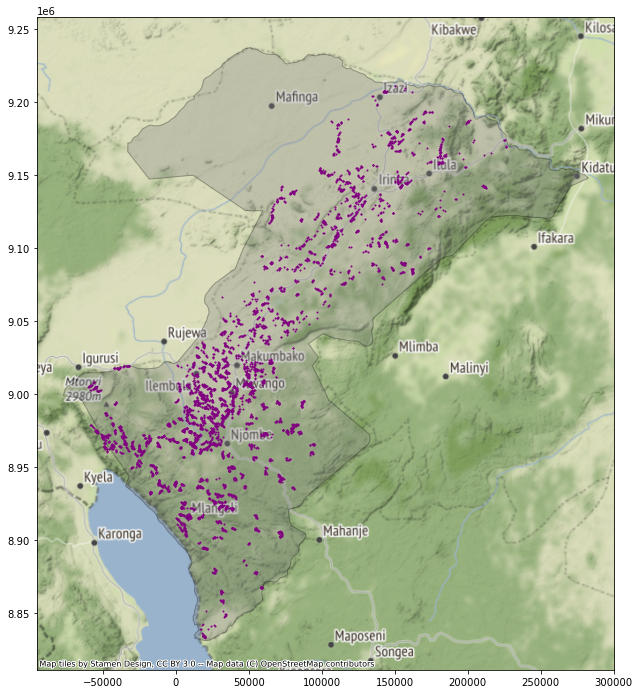

In [234]:
region_to_plot = 'Iringa'

region_plot = old_tz_regions_gdf.loc[[region_to_plot]].plot(
    figsize=(12,12), color='grey', alpha=0.3, edgecolor='black');

# region_water_bodies = tz_regions_geo.loc[[region_to_plot]].overlay(
#     water_bodies_gdf, how='intersection').plot(ax=region_plot);

cx.add_basemap(region_plot, crs=old_tz_regions_gdf.crs)

water_pumps_gdf[['source', 'water_quality', 'geometry', 'region']][water_pumps_gdf['region']==region_to_plot].plot(ax=region_plot, marker='o', color='purple', markersize=1);

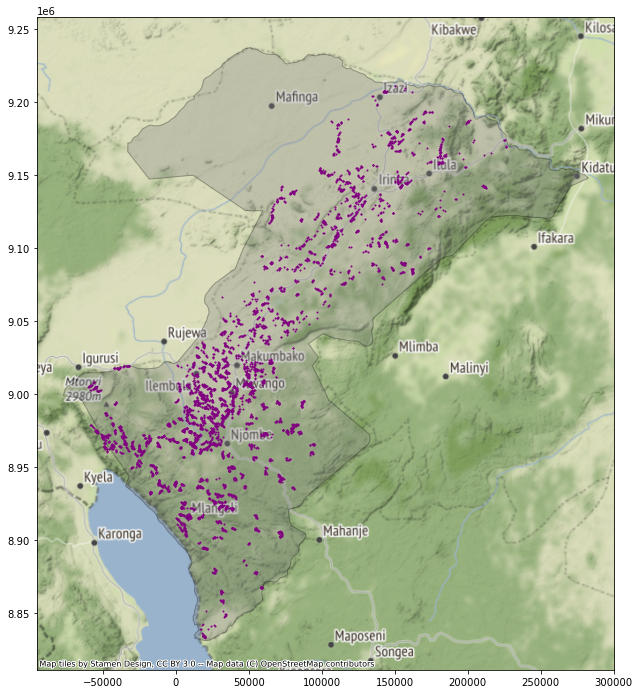

In [235]:
region_to_plot = 'Iringa'

region_plot = old_tz_regions_gdf.loc[[region_to_plot]].plot(
    figsize=(12,12), color='grey', alpha=0.3, edgecolor='black');

# region_water_bodies = tz_regions_geo.loc[[region_to_plot]].overlay(
#     water_bodies_gdf, how='intersection').plot(ax=region_plot);

cx.add_basemap(region_plot, crs=old_tz_regions_gdf.crs)

water_pumps_gdf[['source', 'water_quality', 'geometry', 'region']][water_pumps_gdf['region']==region_to_plot].plot(ax=region_plot, marker='o', color='purple', markersize=1);

In [98]:
water_bodies_gdf.explore()

In [133]:
water_pumps.crs

AttributeError: 'DataFrame' object has no attribute 'crs'

In [150]:
water_pumps.columns

Index(['id', 'amount_tsh', 'date_recorded', 'funder', 'gps_height',
       'installer', 'longitude', 'latitude', 'wpt_name', 'num_private',
       'basin', 'subvillage', 'region', 'region_code', 'district_code', 'lga',
       'ward', 'population', 'public_meeting', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'construction_year',
       'extraction_type', 'extraction_type_group', 'extraction_type_class',
       'management', 'management_group', 'payment', 'payment_type',
       'water_quality', 'quality_group', 'quantity', 'quantity_group',
       'source', 'source_type', 'source_class', 'waterpoint_type',
       'waterpoint_type_group', 'status_group', 'geometry'],
      dtype='object')

In [139]:
tz_regions_geo

,geometry,Region_Cod
Region_Nam,,
Arusha,"POLYGON ((35.83184 -3.42882, 35.83179 -3.42883...",2
Dar-es-salaam,"MULTIPOLYGON (((39.31691 -6.81557, 39.31770 -6...",7
Dodoma,"MULTIPOLYGON (((35.77503 -7.08990, 35.77324 -7...",1
Geita,"MULTIPOLYGON (((31.99989 -3.74618, 31.99752 -3...",25
Iringa,"POLYGON ((35.98175 -8.40394, 35.98175 -8.40396...",11
Kagera,"MULTIPOLYGON (((31.60736 -2.41434, 31.61002 -2...",18
Kaskazini Pemba,"MULTIPOLYGON (((39.64500 -5.14016, 39.64491 -5...",54
Kaskazini Unguja,"MULTIPOLYGON (((39.37027 -5.95762, 39.37123 -5...",51
Katavi,"POLYGON ((32.31989 -7.24260, 32.30045 -7.25315...",23


In [555]:
water_pumps['status_group'].value_counts()

functional                 32259
non functional             22824
functional needs repair     4317
Name: status_group, dtype: int64

Adjusting sb's water pump all columns dataset for line graphs in streamlit

In [596]:
water_gdf_sanitation = pd.DataFrame(columns=['Region', 'Year', 'Type', 'Percentage'])
len(water_gdf_sanitation)

0

In [606]:
water_gdf_sanitation = pd.DataFrame(columns=['Region', 'Year', 'Type', 'Percentage'])


sanitation_types = set([col.split('_')[1] for col in water_gdf.columns if 'sanitation' in col])


# row_count = 0

for type in sanitation_types:
    type_cols = [col for col in water_gdf.columns if 'sanitation_'+type in col]
    for year_of_data in type_cols:
        yd_split = year_of_data.split('_')
        for row in water_gdf[['Region'] + [year_of_data]].iterrows():
            row_df = pd.DataFrame({'Region': [row[1][0]], 'Year': [yd_split[2]], 
                'Type': [type], 'Percentage': [row[1][1]]})
            water_gdf_sanitation = pd.concat([water_gdf_sanitation, row_df], axis=0)
            # row_count += 1

    # break

water_gdf_sanitation.to_csv('st_data/sanitation_by_region.csv')
water_gdf_sanitation.shape

(504, 4)

In [611]:
water_gdf_levels = pd.DataFrame(columns=['Region', 'Year', 'Type', 'Percentage'])

level_types = set([col.split('_')[1] for col in water_gdf.columns if 'water' in col[:5]])

for type in level_types:
    type_cols = [col for col in water_gdf.columns if 'water_'+type in col]
    for year_of_data in type_cols:
        yd_split = year_of_data.split('_')
        for row in water_gdf[['Region'] + [year_of_data]].iterrows():
            row_df = pd.DataFrame({'Region': [row[1][0]], 'Year': [yd_split[2]], 
                'Type': [type], 'Percentage': [row[1][1]]})
            water_gdf_levels = pd.concat([water_gdf_levels, row_df], axis=0)
            # row_count += 1

    # break

water_gdf_levels.to_csv('st_data/drinking_water_quality_by_region.csv')
water_gdf_levels.shape

(504, 4)

In [610]:
water_gdf_levels

,Region,Year,Type,Percentage
0,Kagera,2005,surface,41.74589
0,Mara,2005,surface,42.98146
0,Mwanza,2005,surface,28.73255
0,Shinyanga,2005,surface,13.66871
0,Kilimanjaro,2005,surface,14.80378
...,...,...,...,...
0,Mtwara,2017,unimproved,25.55541
0,Pwani,2017,unimproved,16.65056
0,Dar-es-salaam,2017,unimproved,5.8238
0,Arusha,2017,unimproved,4.76088


In [ ]:
mon_avg_rain30 = pd.read_csv('pr_climatology_annual-monthly_cru_1991-2020_TZA.csv', header=1)
mon_avg_rain30 = mon_avg_rain30.rename({'Unnamed: 0': 'Region'}, axis = 1)
mon_avg_rain30.head()

In [19]:
regions_of_interest = mon_avg_rain30.iloc[1:, 0]
# tz_census_regions = tz_census[(tz_census['Area'] != 'Mainland') & (tz_census['Area'] != 'Tanzania')]
tz_census_regions = tz_census[tz_census['Area'].isin(regions_of_interest)] # df of indicators for regions, not whole country

NameError: name 'mon_avg_rain30' is not defined